# Reference

**Reference:**
[1] Ho, J., Jain, A., and Abbeel, P. (2020) Denoising diffusion probabilistic models.

[2] Vaswani, A., Shazeer, N., Parmar, N., Uszkoreit, J., Jones, L., Gomez, A. N., Kaiser, L.; and
Polosukhin, I. (2017). Attention Is All You Need.

[3] Phil Wang. Denoising Diffusion Probabilistic Model, in Pytorch. Github repository,
https://github.com/lucidrains/denoising-diffusion-pytorch

[4] Rogge, Niels, and Kashif Rasul. “Google Colaboratory.” Google Colab, Google Colab Notebook,
colab.research.google.com/github/huggingface/notebooks/blob/main/examples/annotated_diffusion.ipy
nb.

[5] LeCun, Y., Cortes, C. and Burges, C.J.C. (1998) The MNIST Database of Handwritten Digits. New
York, USA. http://yann.lecun.com/exdb/mnist/

[6] Schuler, J. P. S (2021). CIFAR-10 64x64 Resized via CAI Super Resolution. Version 1.
https://www.kaggle.com/discussions/general/46091

[7] O. M. Parkhi, A. Vedaldi, A. Zisserman, C. V. Jawahar (2012), Cats and Dogs, IEEE Conference on
Computer Vision and Pattern Recognition, 2012

[8] DeepFindr. “Diffusion Models from Scratch in Pytorch.” YouTube, 17 July 2022,
www.youtube.com/watch?v=a4Yfz2FxXiY.

[9] Arora, Aman. “U-Net A PyTorch Implementation in 60 Lines of Code.” Aman Arora’s Blog, 30
Aug. 2020, https://amaarora.github.io/posts/2020-09-13-unet.html.

[10] Hedu AI by Batool Haider. “Visual Guide to Transformer Neural Networks – (Episode 2) MultiHead & Self-Attention”. YouTube, 8 December 2020,
https://www.youtube.com/watch?v=mMa2PmYJlCo

[11] Outlier. “Diffusion Models | Pytorch Implementation”. YouTube, 20 September 2022,
https://www.youtube.com/watch?v=TBCRlnwJtZU

In [ ]:
import torch
import torchvision
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader, Subset
import torch.nn.functional as F
import numpy as np
from torch.utils.data import Dataset

from pathlib import Path
from kaggle import api
from fastdownload import FastDownload


from utils import linear_schedule,sigmoid_beta_schedule, add_noise, denoise_step, sample_plot_image, show_tensor_image
from diffusion_model import Unet

# Import and Visualize Image

In [ ]:
import json
import os
from pathlib import Path

# your api key
api_key = {
'username':"" ,
'key':""}

# uses pathlib Path
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

# opens file and dumps python dict to json object
with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_key,handl)

os.chmod(kaggle_path/'kaggle.json', 600)

In [ ]:
def get_kaggle_dataset(dataset_path,dataset_slug, unzip=True, force=False):
    '''Downloads an existing dataset and metadata from kaggle'''
    if not force and Path(dataset_path).exists():
        return Path(dataset_path)
    api.dataset_metadata(dataset_slug, str(dataset_path))
    api.dataset_download_files(dataset_slug, str(dataset_path))
    if unzip:
        zipped_file = Path(dataset_path)/f"{dataset_slug.split('/')[-1]}.zip"
        import zipfile
        with zipfile.ZipFile(zipped_file, 'r') as zip_ref:
            zip_ref.extractall(Path(dataset_path))
        zipped_file.unlink()

In [ ]:
cifar_labels = "airplane,automobile,bird,cat,deer,dog,frog,horse,ship,truck".split(",")


In [ ]:
def untar_data(url, force_download=False, base='./datasets'):
    d = FastDownload(base=base)
    return d.get(url, force=force_download, extract_key='data')

def get_cifar(cifar100=False, img_size=64):
    get_kaggle_dataset("datasets/cifar10_64", "joaopauloschuler/cifar10-64x64-resized-via-cai-super-resolution")
    return Path("datasets/cifar10_64/cifar10-64")

In [ ]:
path = get_cifar()

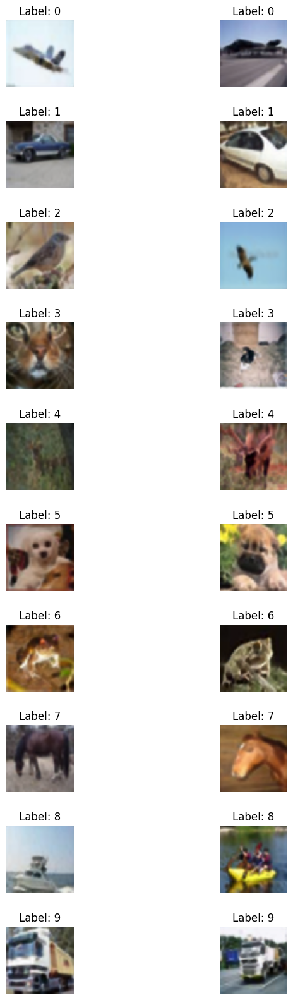

In [ ]:
img_size = 64
train_transforms = torchvision.transforms.Compose([
        transforms.ToTensor(),
    ])
train_dataset = torchvision.datasets.ImageFolder(os.path.join(path, "train"),transform=train_transforms)
def visualize_images_by_label(dataset, num_labels=10, images_per_label=2):
      fig, axs = plt.subplots(num_labels, images_per_label, figsize=(images_per_label*4, num_labels*2))
      plt.subplots_adjust(hspace=0.5)
      label_counts = {label: 0 for label in range(num_labels)}

      for image, label in dataset:
          if label_counts[label] < images_per_label:
              ax = axs[label, label_counts[label]]
              ax.imshow(image.permute(1, 2, 0))  # Reorder dimensions for matplotlib
              ax.set_title(f"Label: {label}")
              ax.axis('off')
              label_counts[label] += 1

          if all(count >= images_per_label for count in label_counts.values()):
              break

      plt.show()
visualize_images_by_label(train_dataset)

# Data Augmentation

In [ ]:
def get_cifar_data(dataset_path, img_size=64, train_folder="train", val_folder="test"):
    data_transforms = torchvision.transforms.Compose([
        transforms.Resize(img_size + int(.25*img_size)),  # img_size + 1/4 *img_size
        transforms.RandomResizedCrop(img_size, scale=(0.8, 1.0)),
        transforms.ToTensor(),
        transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1]
    ])


    train_dataset = torchvision.datasets.ImageFolder(os.path.join(dataset_path, train_folder), transform=data_transforms)
    val_dataset = torchvision.datasets.ImageFolder(os.path.join(dataset_path, val_folder), transform=data_transforms)

    def filter_label_zero(dataset):
        indices = [i for i, (_, label) in enumerate(dataset) if label in [1]]
        return Subset(dataset, indices)

    train_filtered = filter_label_zero(train_dataset)
    test_filtered = filter_label_zero(val_dataset)
    #print(len(train_filtered))


    combined_dataset = torch.utils.data.ConcatDataset([train_filtered,test_filtered])
    return combined_dataset


In [ ]:
IMG_SIZE = 64
BATCH_SIZE = 10
data = get_cifar_data(path)
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True)

In [ ]:
len(data)

6000

# Building the Diffusion Model


## Step 1: The forward process = Noise scheduler







the forward diffusion process \\(q(\mathbf{x}_t | \mathbf{x}_{t-1})\\) which adds Gaussian noise at each time step \\(t\\), with known variance schedule \\(0<\beta_T < 1\\) as


$$q(\mathbf{x}_t | \mathbf{x}_0) = \cal{N}(\mathbf{x}_t; \sqrt{\bar{\alpha}_t} \mathbf{x}_0, (1- \bar{\alpha}_t) \mathbf{I})$$

with \\(\alpha_t := 1 - \beta_t\\) and \\(\bar{\alpha}t := \Pi_{s=1}^{t} \alpha_s\\).



In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
T = 1000  # Total number of timesteps
# Precompute terms for the diffusion process
#betas = linear_schedule(T).to(device)  # [T]
betas = sigmoid_beta_schedule(T).to(device)  # [T]
alphas = 1.0 - betas  # [T]
alphas_cumprod = torch.cumprod(alphas, dim=0)  # [T]

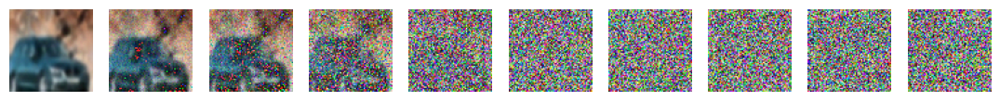

In [ ]:
# Simulate forward diffusion
#[BATCH_SIZE, C, H, W]
image = next(iter(dataloader))[0]

plt.figure(figsize=(15,15))
num_images = 10
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    #creates tensor tensor([idx])
    t = torch.Tensor([idx]).type(torch.int64)
    plt.subplot(1, num_images+1, int(idx/stepsize) + 1)
    plt.axis('off')
    img, noise = add_noise(image, t)
    show_tensor_image(img.to('cpu'))

In [ ]:
len(data)

6000

## Step 2: The backward process = U-Net



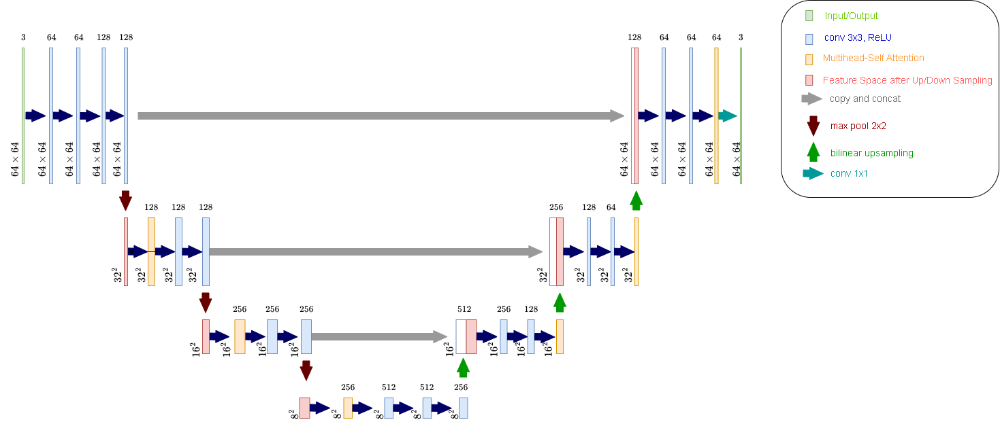

In [ ]:
model = Unet(use_groupnorm=False,use_relu=False)
#model = UNet()
print("Num params: ", sum(p.numel() for p in model.parameters()))
model

Num params:  15585923


Unet(
  (conv0): Block(
    (double_conv): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): GELU(approximate='none')
      (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (4): GELU(approximate='none')
      (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
  )
  (down1): Down(
    (down_conv_block): Sequential(
      (0): Block(
        (double_conv): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (1): GELU(approximate='none')
          (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (4): GELU(approximate='none')
          (5): BatchNorm2d(128, ep

In [ ]:
#load pretrained model
# model.load_state_dict(torch.load('model_cifar10_car_adjusted_v3.pth'))
# device = torch.device("cuda")
# model.to(device)

Unet(
  (conv0): Block(
    (double_conv): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): GELU(approximate='none')
      (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (4): GELU(approximate='none')
      (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
  )
  (down1): Down(
    (down_conv_block): Sequential(
      (0): Block(
        (double_conv): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (1): GELU(approximate='none')
          (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (4): GELU(approximate='none')
          (5): BatchNorm2d(128, ep

## Step 3: The loss



- L1 or L2 loss with predicted noise and actual noise


In [ ]:
def get_loss(model, x_0, t):
    #x_noisy, noise = add_noise(x_0, t, device)
    x_noisy, noise = add_noise(x_0, t)
    noise_pred = model(x_noisy, t)
    return F.mse_loss(noise, noise_pred)

## Sampling
Mean is sampled with
$$ \mathbf{\mu}_\theta(\mathbf{x}_t, t) = \frac{1}{\sqrt{\alpha_t}} \left(  \mathbf{x}_t - \frac{\beta_t}{\sqrt{1- \bar{\alpha}_t}} \mathbf{\epsilon}_\theta(\mathbf{x}_t, t) \right)$$

Sampling with constant variance

## Training



<p align="center">
    <img src="https://drive.google.com/uc?id=1LJsdkZ3i1J32lmi9ONMqKFg5LMtpSfT4" width="400" />
</p>

* we take random samples $\mathbf{x}_0$ from the original data  $q(\mathbf{x}_0)$
* we sample timestamp $t$ uniformally between $1$ and $T$
* we sample some noise and corrupt the sampled images by this noise at level $t$
* the neural network is trained to predict this noise based on the noisified image $\mathbf{x}_t$, and the actual noise based on known schedule $\beta_t$
* take gradient descent and update model weights until enough epochs

Epoch 0 | step 000 Loss: 0.021670550107955933 


<ipython-input-13-64d73887ee3d>:103: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images, num_images - i // stepsize)


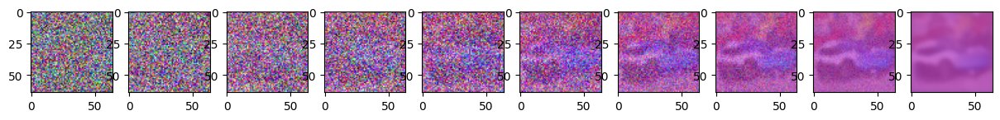

Epoch 1 | step 000 Loss: 0.0195732731372118 


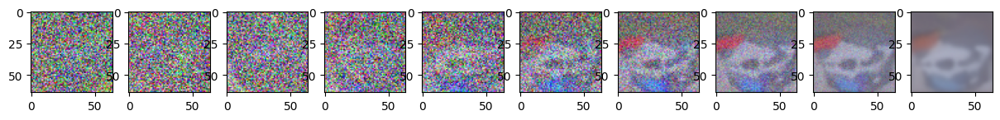

Epoch 2 | step 000 Loss: 0.01878350041806698 


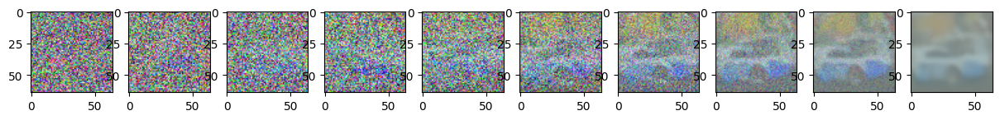

Epoch 3 | step 000 Loss: 0.013879645615816116 


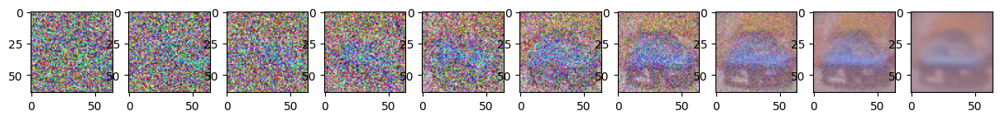

Epoch 4 | step 000 Loss: 0.021811308339238167 


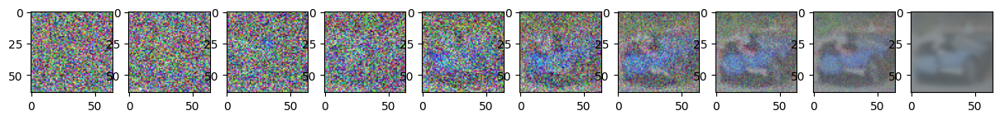

Epoch 5 | step 000 Loss: 0.014999469742178917 


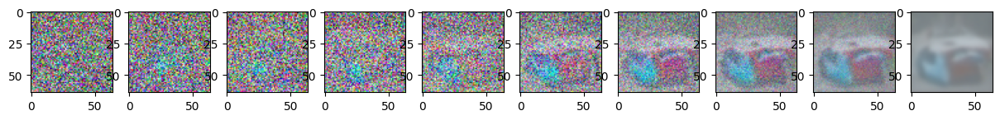

Epoch 6 | step 000 Loss: 0.01852012239396572 


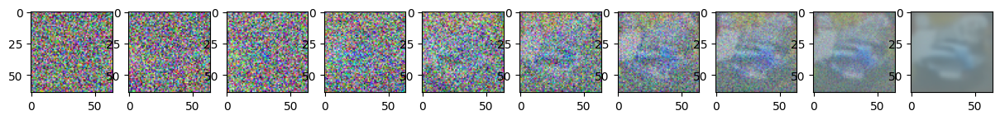

Epoch 7 | step 000 Loss: 0.010315652936697006 


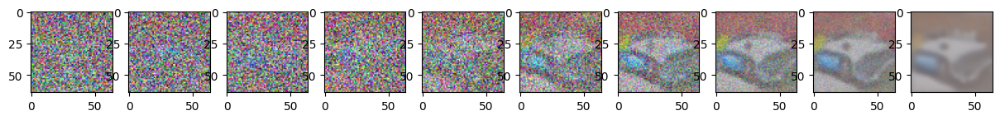

Epoch 8 | step 000 Loss: 0.015983229503035545 


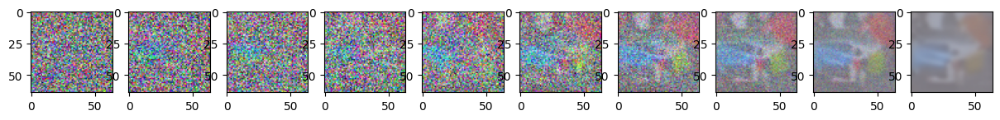

Epoch 9 | step 000 Loss: 0.019573889672756195 


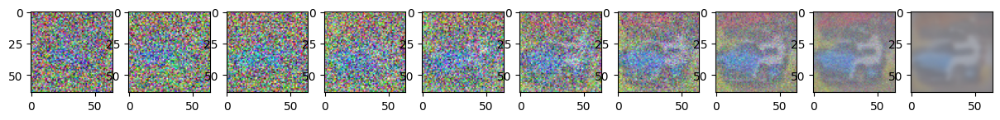

Epoch 10 | step 000 Loss: 0.012420553714036942 


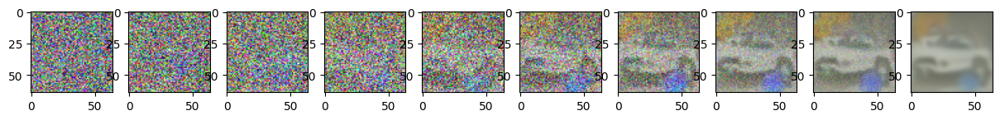

Epoch 11 | step 000 Loss: 0.02860686555504799 


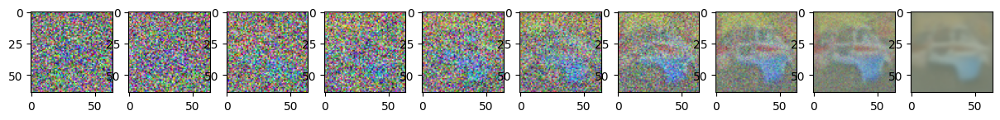

Epoch 12 | step 000 Loss: 0.012022720649838448 


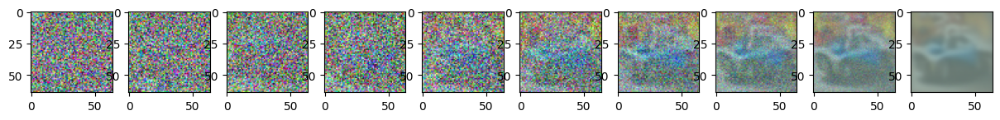

Epoch 13 | step 000 Loss: 0.019248362630605698 


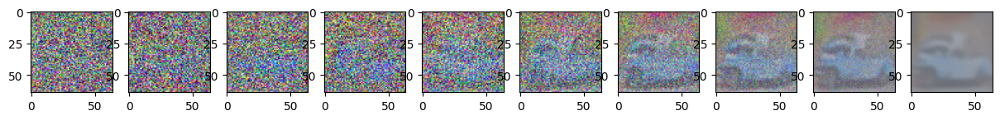

Epoch 14 | step 000 Loss: 0.02228863723576069 


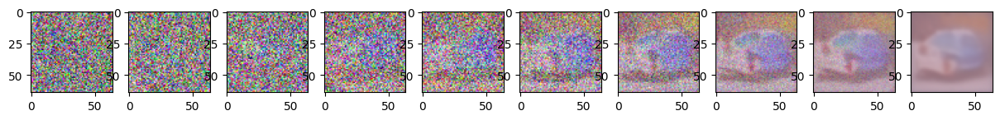

Epoch 15 | step 000 Loss: 0.019976994022727013 


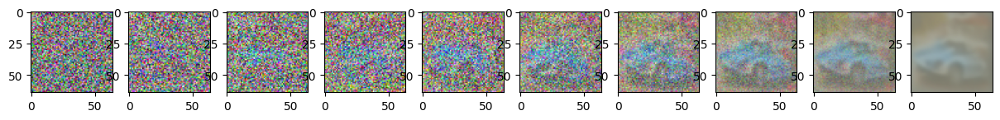

Epoch 16 | step 000 Loss: 0.03627477586269379 


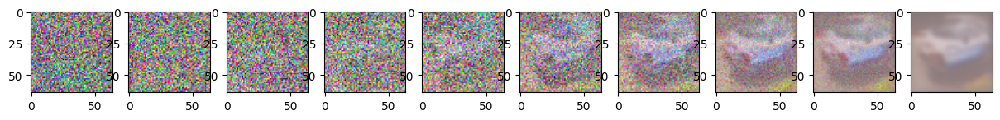

Epoch 17 | step 000 Loss: 0.016230612993240356 


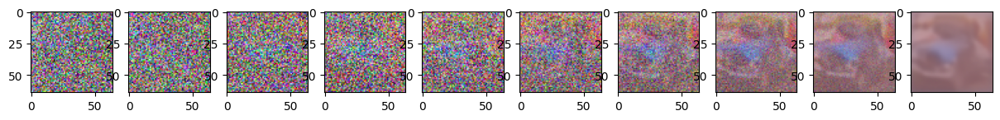

Epoch 18 | step 000 Loss: 0.01443462260067463 


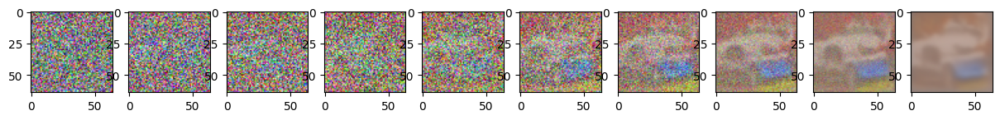

Epoch 19 | step 000 Loss: 0.01713680475950241 


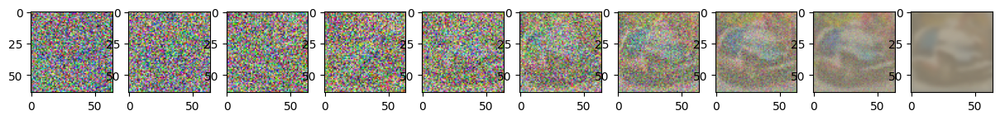

Epoch 20 | step 000 Loss: 0.020562082529067993 


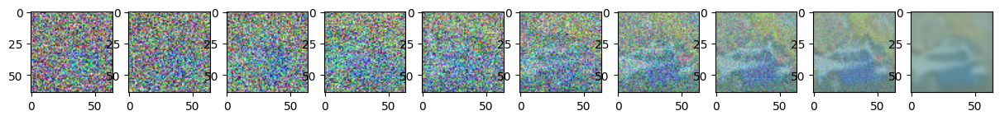

Epoch 21 | step 000 Loss: 0.04647819697856903 


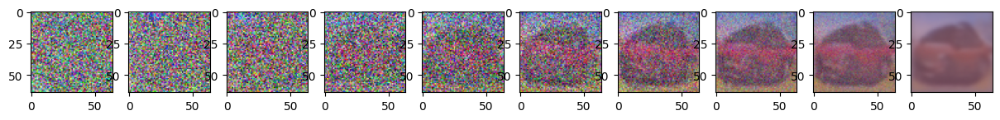

Epoch 22 | step 000 Loss: 0.022619178518652916 


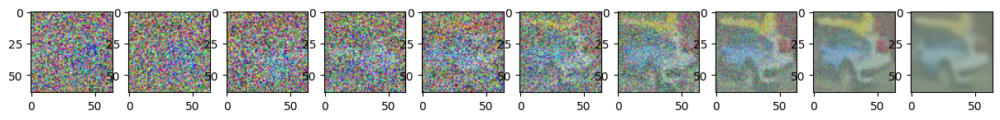

Epoch 23 | step 000 Loss: 0.029065893962979317 


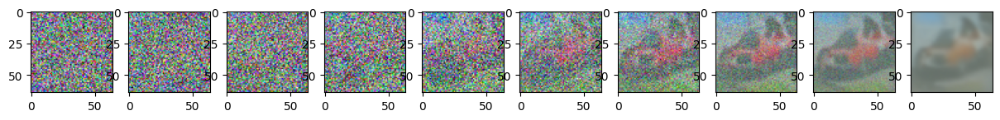

Epoch 24 | step 000 Loss: 0.024597615003585815 


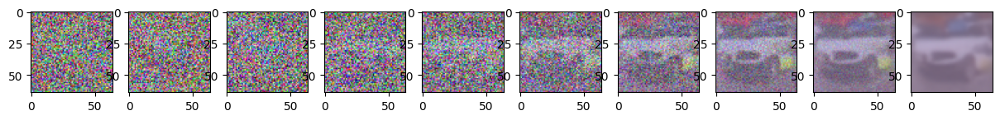

Epoch 25 | step 000 Loss: 0.03310057148337364 


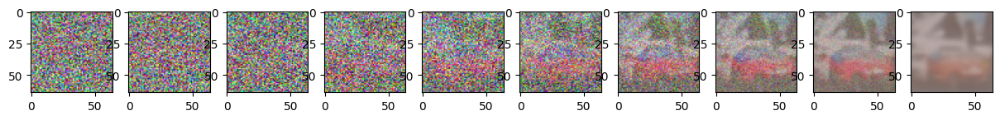

Epoch 26 | step 000 Loss: 0.025193657726049423 


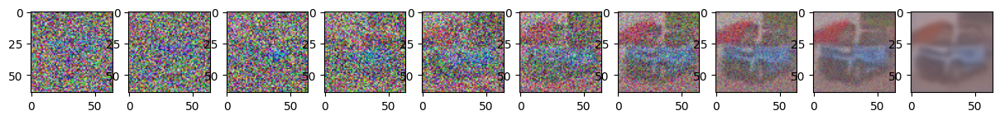

Epoch 27 | step 000 Loss: 0.018128331750631332 


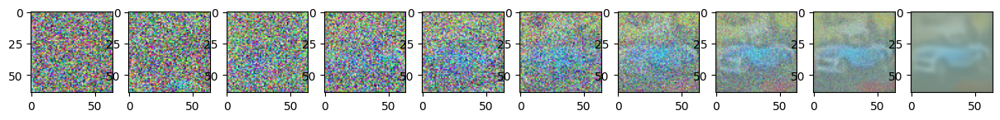

Epoch 28 | step 000 Loss: 0.028012339025735855 


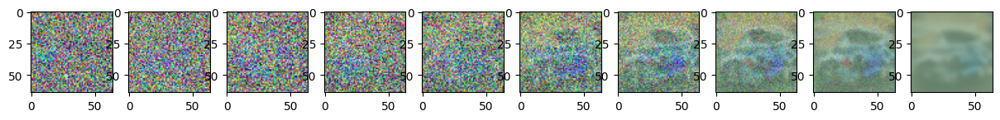

Epoch 29 | step 000 Loss: 0.018758906051516533 


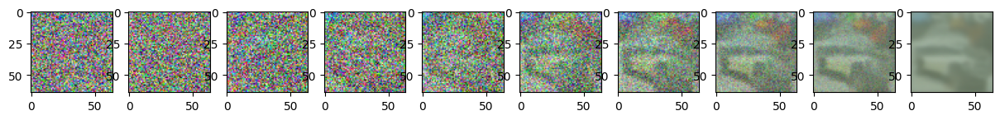

Epoch 30 | step 000 Loss: 0.012549466453492641 


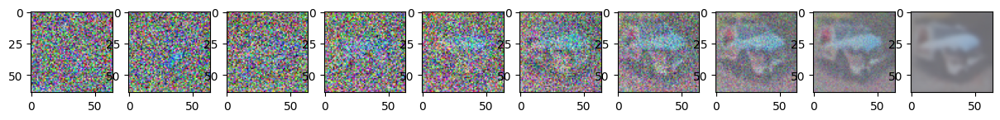

Epoch 31 | step 000 Loss: 0.009903395548462868 


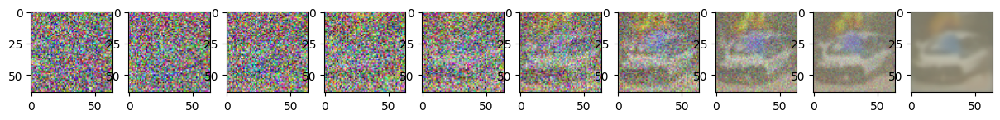

Epoch 32 | step 000 Loss: 0.016308292746543884 


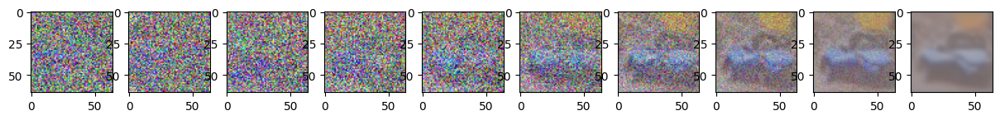

Epoch 33 | step 000 Loss: 0.006490603554993868 


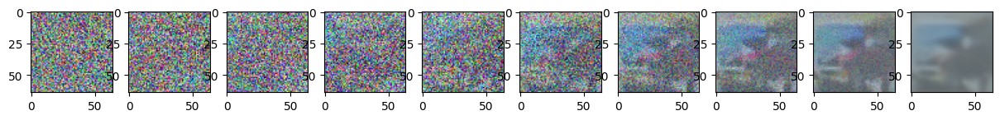

Epoch 34 | step 000 Loss: 0.03580201044678688 


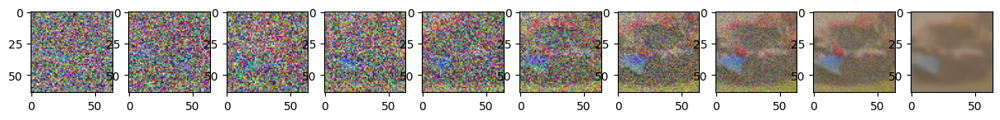

Epoch 35 | step 000 Loss: 0.020792081952095032 


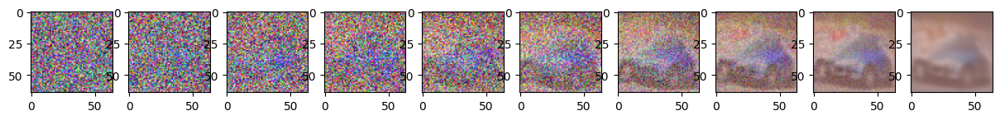

Epoch 36 | step 000 Loss: 0.029111482203006744 


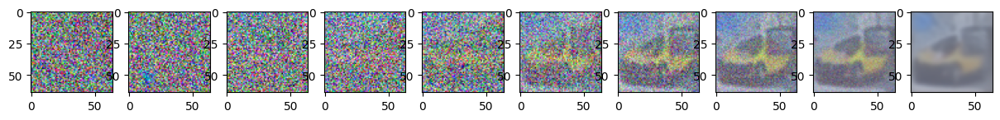

Epoch 37 | step 000 Loss: 0.030299557372927666 


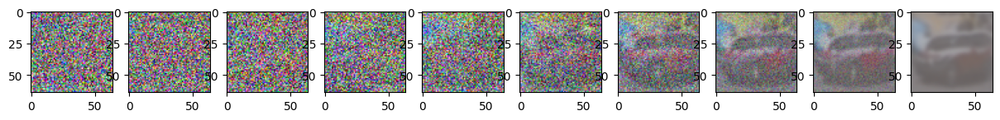

Epoch 38 | step 000 Loss: 0.04367966949939728 


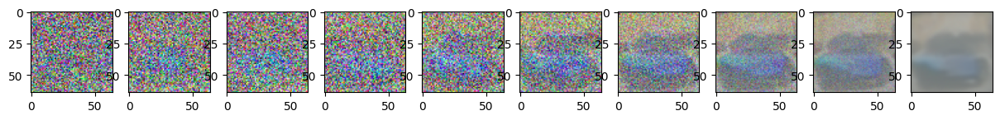

Epoch 39 | step 000 Loss: 0.042578499764204025 


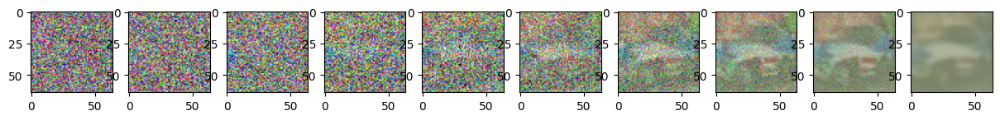

Epoch 40 | step 000 Loss: 0.02728690393269062 


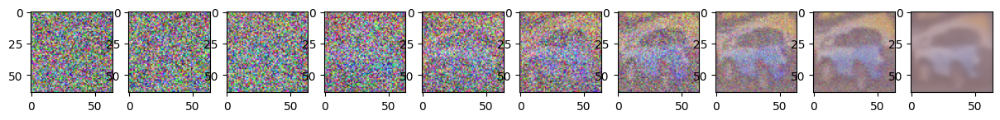

Epoch 41 | step 000 Loss: 0.024966971948742867 


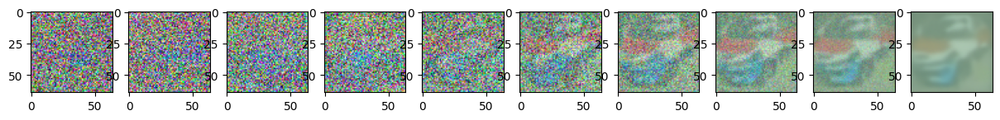

Epoch 42 | step 000 Loss: 0.009865113534033298 


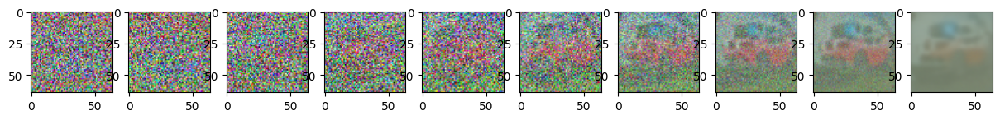

Epoch 43 | step 000 Loss: 0.03170308843255043 


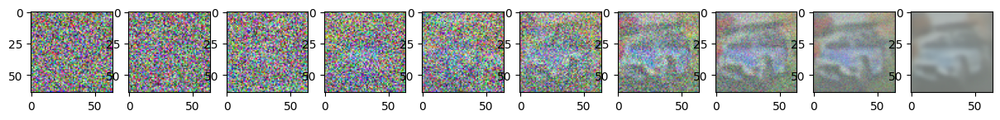

Epoch 44 | step 000 Loss: 0.010053744539618492 


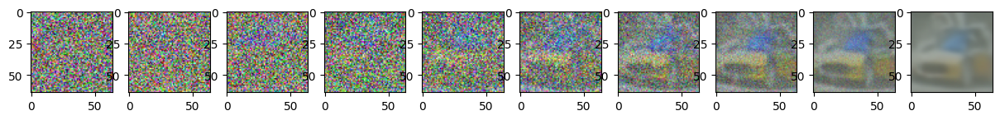

Epoch 45 | step 000 Loss: 0.015514591708779335 


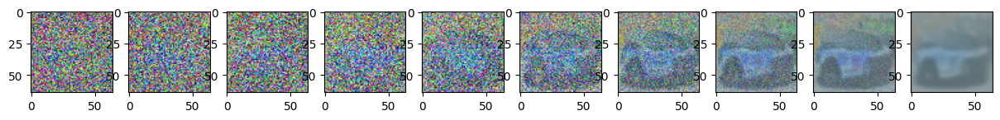

Epoch 46 | step 000 Loss: 0.05017140507698059 


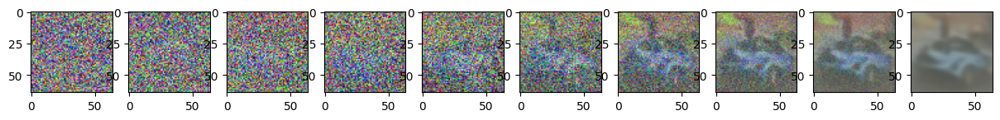

Epoch 47 | step 000 Loss: 0.016425490379333496 


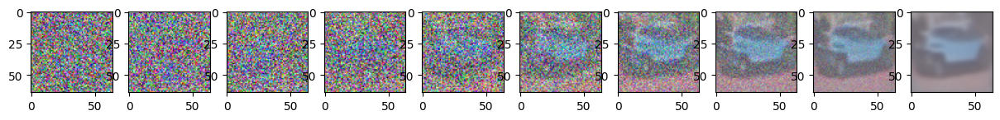

Epoch 48 | step 000 Loss: 0.006491170730441809 


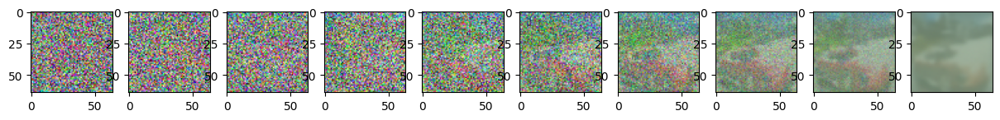

Epoch 49 | step 000 Loss: 0.018581373617053032 


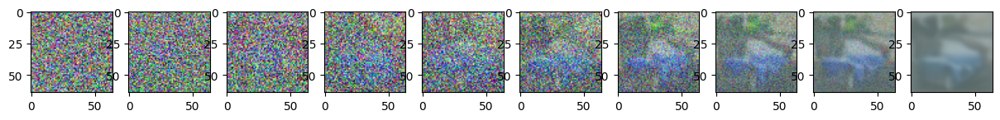

Epoch 50 | step 000 Loss: 0.01816480979323387 


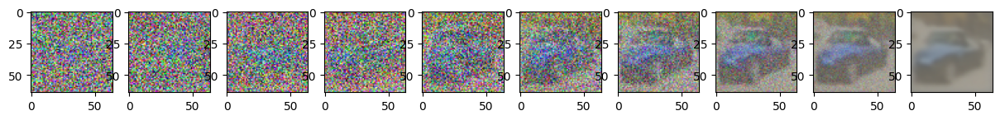

Epoch 51 | step 000 Loss: 0.02165950834751129 


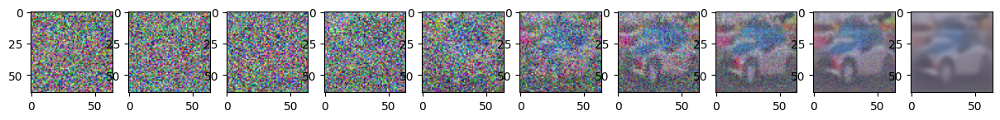

Epoch 52 | step 000 Loss: 0.013650656677782536 


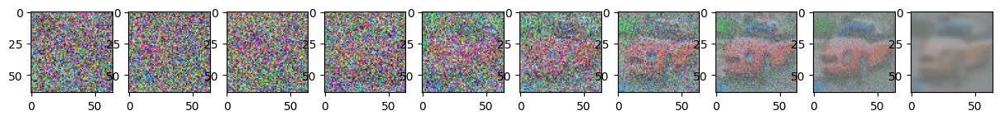

Epoch 53 | step 000 Loss: 0.013994663022458553 


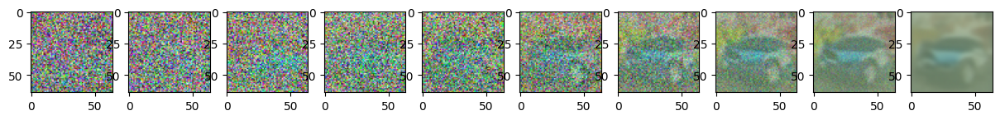

Epoch 54 | step 000 Loss: 0.017368968576192856 


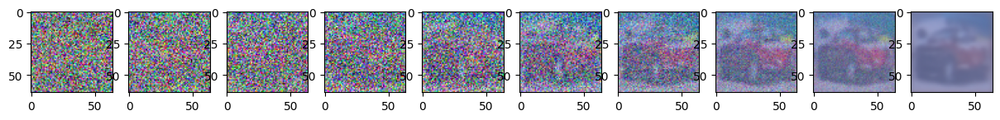

Epoch 55 | step 000 Loss: 0.015259528532624245 


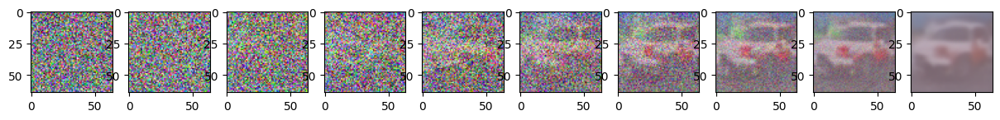

Epoch 56 | step 000 Loss: 0.0306256040930748 


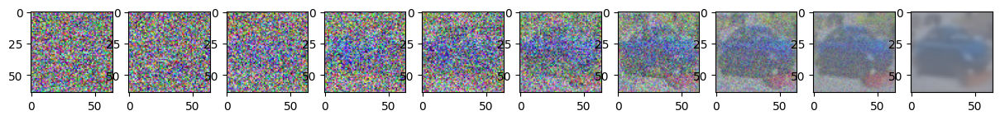

Epoch 57 | step 000 Loss: 0.021482402458786964 


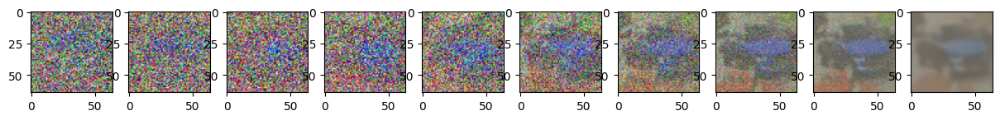

Epoch 58 | step 000 Loss: 0.034514497965574265 


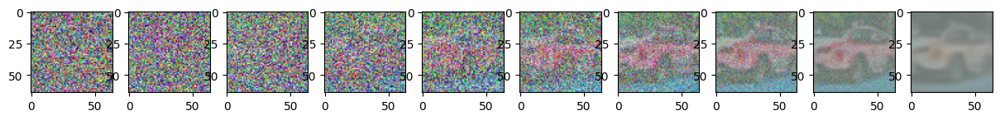

Epoch 59 | step 000 Loss: 0.015286299400031567 


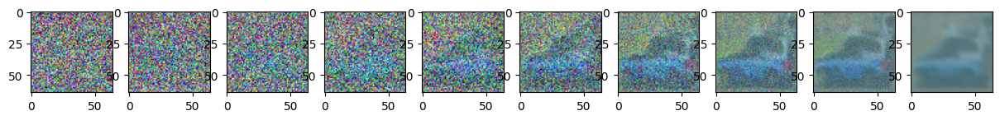

Epoch 60 | step 000 Loss: 0.018876763060688972 


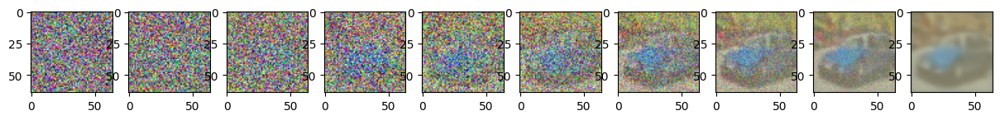

Epoch 61 | step 000 Loss: 0.0286457147449255 


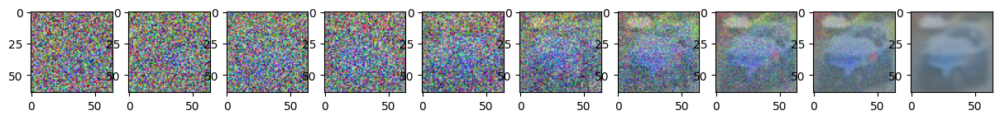

Epoch 62 | step 000 Loss: 0.019021015614271164 


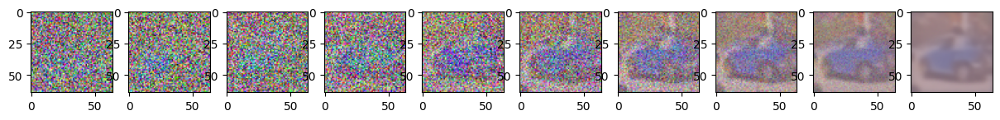

Epoch 63 | step 000 Loss: 0.010000570677220821 


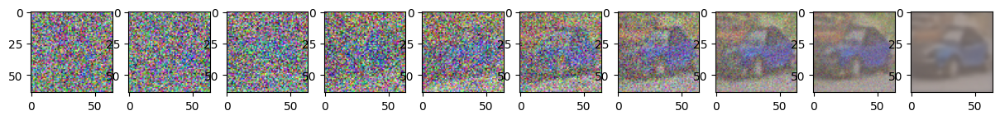

Epoch 64 | step 000 Loss: 0.019452396780252457 


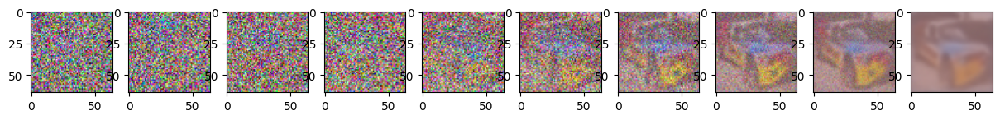

Epoch 65 | step 000 Loss: 0.02154632844030857 


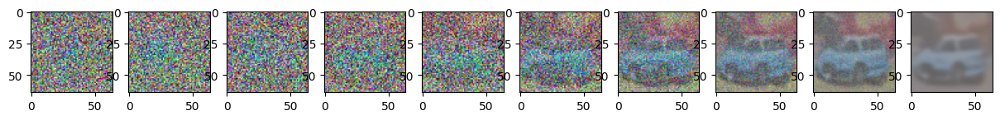

Epoch 66 | step 000 Loss: 0.008386216126382351 


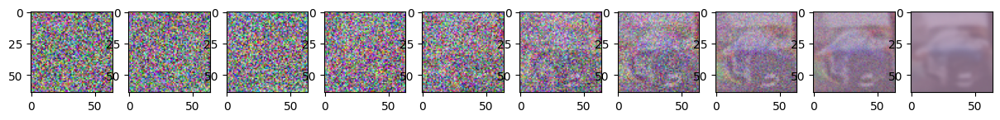

Epoch 67 | step 000 Loss: 0.033619221299886703 


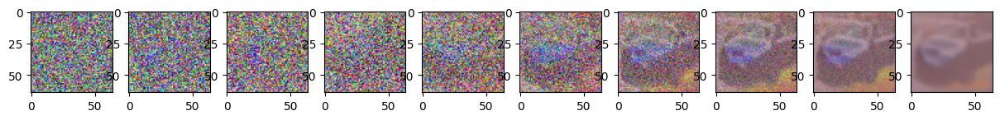

Epoch 68 | step 000 Loss: 0.019077645614743233 


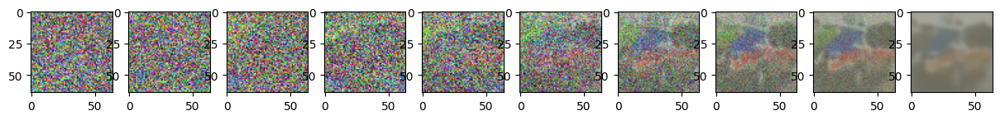

Epoch 69 | step 000 Loss: 0.014535389840602875 


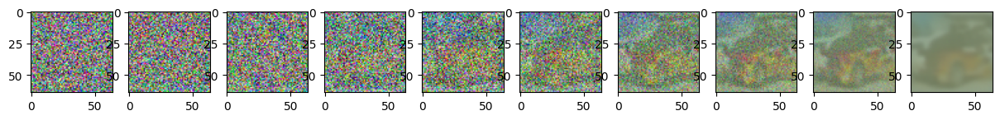

Epoch 70 | step 000 Loss: 0.026568930596113205 


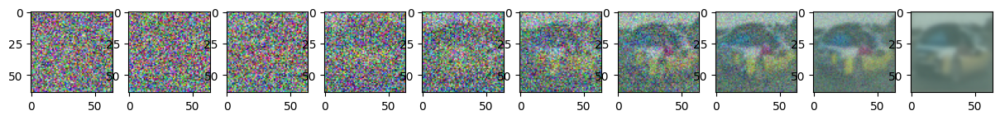

Epoch 71 | step 000 Loss: 0.035040292888879776 


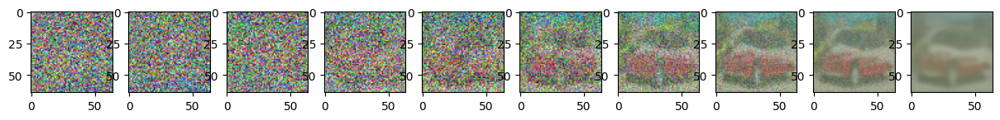

Epoch 72 | step 000 Loss: 0.009545070119202137 


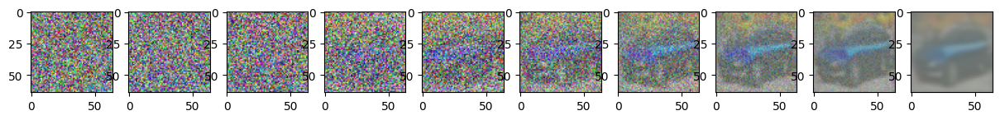

Epoch 73 | step 000 Loss: 0.01697183959186077 


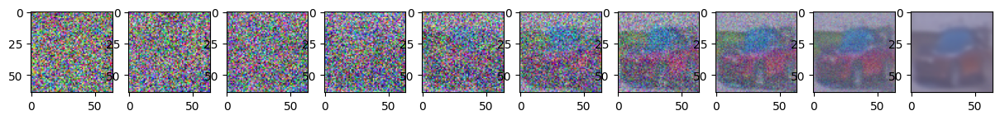

Epoch 74 | step 000 Loss: 0.03133806213736534 


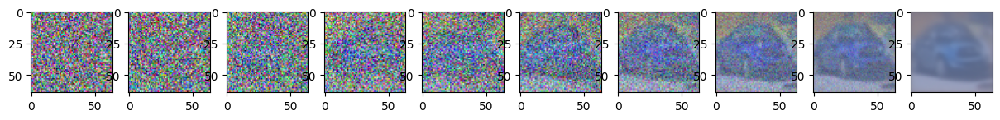

Epoch 75 | step 000 Loss: 0.029532695189118385 


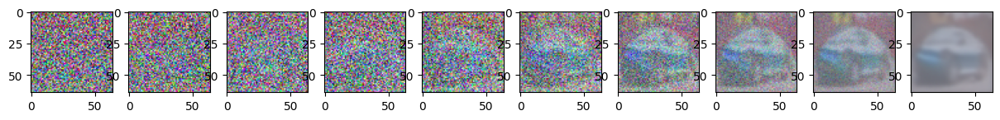

Epoch 76 | step 000 Loss: 0.01699678972363472 


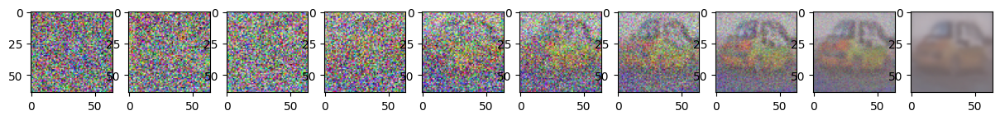

Epoch 77 | step 000 Loss: 0.017684519290924072 


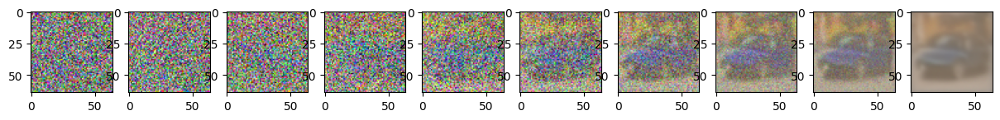

Epoch 78 | step 000 Loss: 0.013964787125587463 


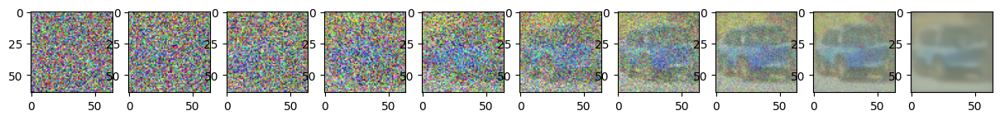

Epoch 79 | step 000 Loss: 0.02059929631650448 


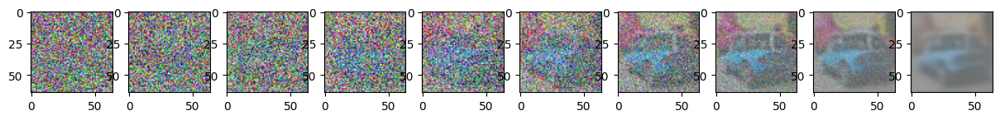

Epoch 80 | step 000 Loss: 0.018311334773898125 


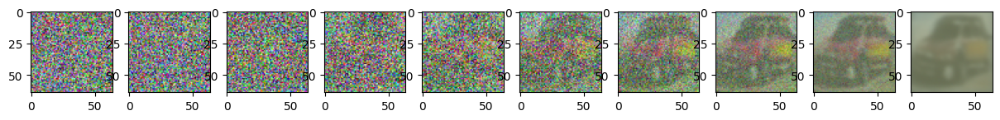

Epoch 81 | step 000 Loss: 0.02325480431318283 


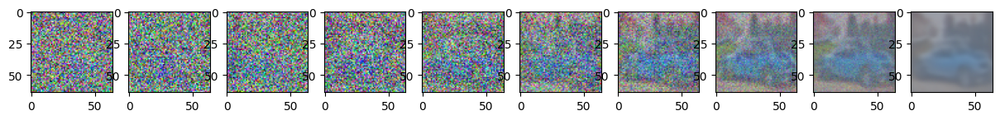

Epoch 82 | step 000 Loss: 0.013171190395951271 


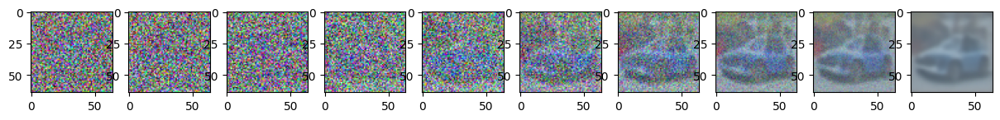

Epoch 83 | step 000 Loss: 0.01498447172343731 


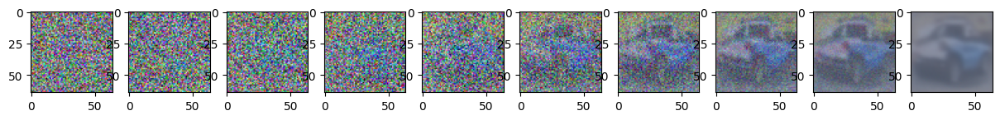

Epoch 84 | step 000 Loss: 0.018869973719120026 


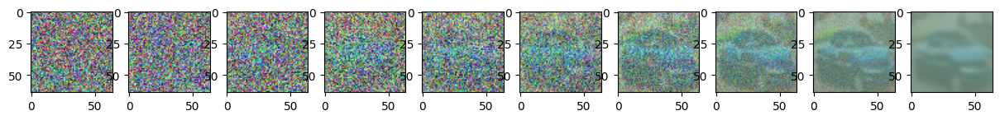

Epoch 85 | step 000 Loss: 0.02087736688554287 


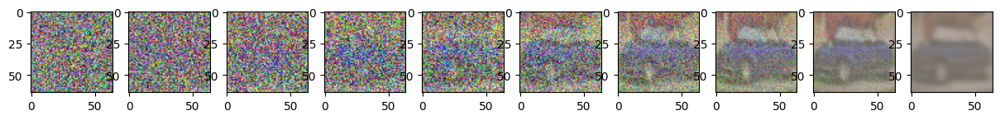

Epoch 86 | step 000 Loss: 0.03174032270908356 


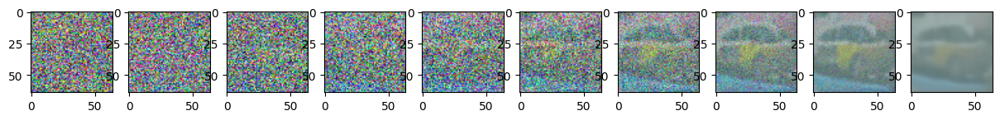

Epoch 87 | step 000 Loss: 0.018046248704195023 


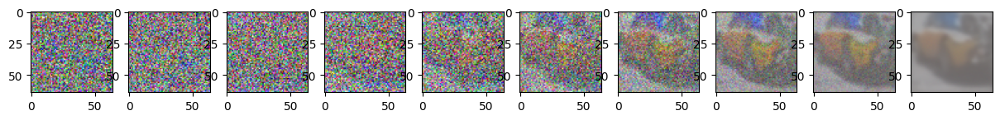

Epoch 88 | step 000 Loss: 0.02459614723920822 


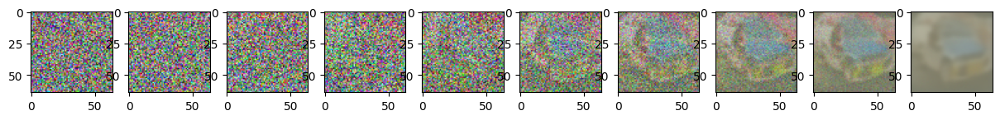

Epoch 89 | step 000 Loss: 0.011462202295660973 


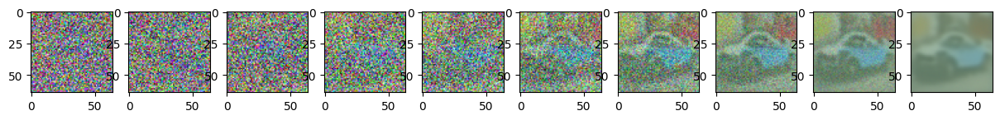

Epoch 90 | step 000 Loss: 0.016065195202827454 


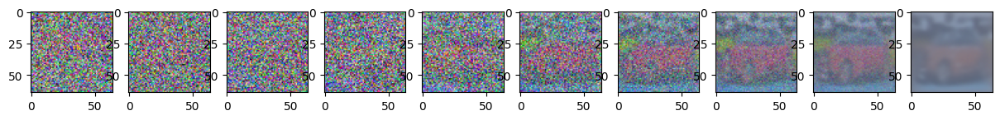

Epoch 91 | step 000 Loss: 0.029847051948308945 


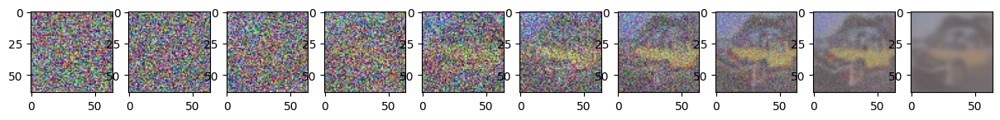

Epoch 92 | step 000 Loss: 0.01689848303794861 


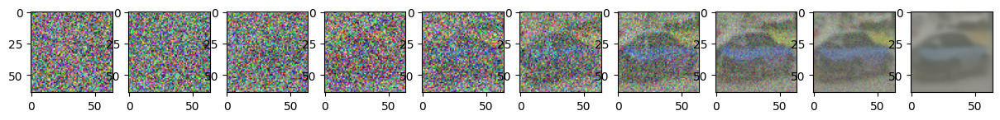

Epoch 93 | step 000 Loss: 0.03738360479474068 


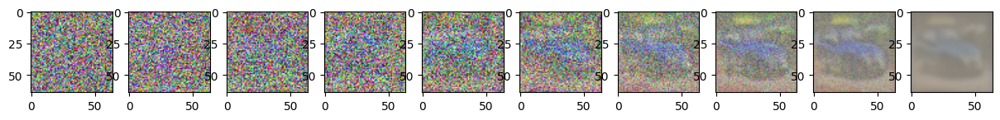

Epoch 94 | step 000 Loss: 0.02449355646967888 


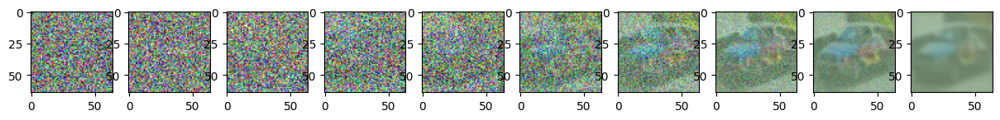

Epoch 95 | step 000 Loss: 0.015501841902732849 


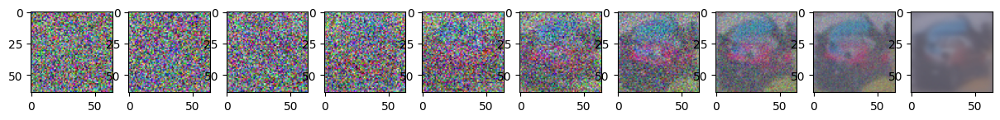

Epoch 96 | step 000 Loss: 0.019136957824230194 


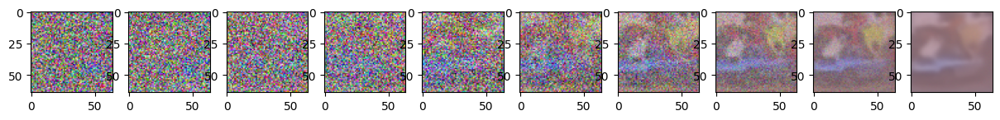

Epoch 97 | step 000 Loss: 0.014193260110914707 


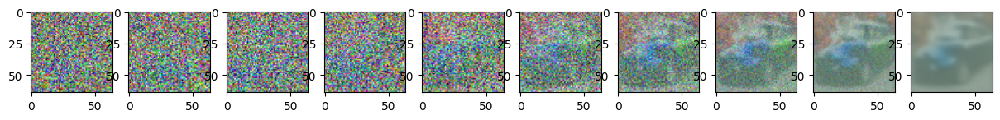

Epoch 98 | step 000 Loss: 0.02301597408950329 


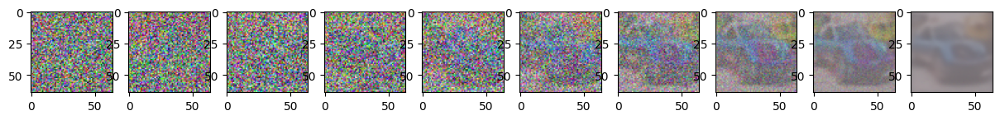

Epoch 99 | step 000 Loss: 0.029805820435285568 


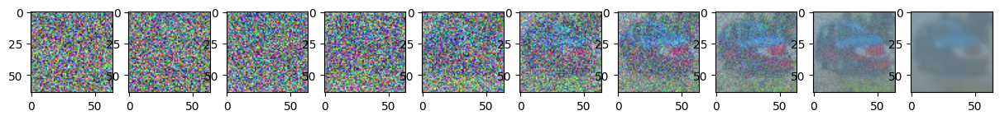

In [ ]:
from torch.optim import AdamW
import copy
device = "cuda"
model.to(device)
optimizer = AdamW(model.parameters(), lr=0.0003)
epochs = 200
img_size = IMG_SIZE


for epoch in range(epochs):
    for step, batch in enumerate(dataloader):
      optimizer.zero_grad()
      # dimention (batchsize,)
      t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
      loss = get_loss(model, batch[0], t)
      loss.backward()
      optimizer.step()

      #if step % 500==0:
      if epoch % 1 == 0 and step == 0:
        print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
        sample_plot_image(model,img_size)
      # if epoch % 10 == 0 and epoch != 0 and step == 0:
      #   PATH = "model_cifar10_car_adjusted_v3.pth"
      #   torch.save(model.state_dict(), PATH)


<ipython-input-13-64d73887ee3d>:103: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images, num_images - i // stepsize)


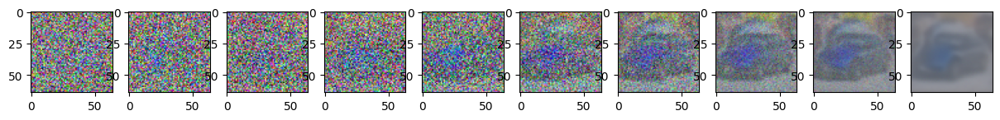

In [ ]:
img_size = IMG_SIZE

sample_plot_image(model,img_size)

# save model

In [ ]:
# from google.colab import drive

# drive.mount('/content/drive')
# %cd /content/drive/MyDrive/ECE1508/PROJ/

In [ ]:
# PATH = "model_cifar10_car_adjusted_v3.pth"
# torch.save(model.state_dict(), PATH)